## Importing necessary libaries

In [41]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, LabelEncoder, KBinsDiscretizer

from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from imblearn.ensemble import BalancedRandomForestClassifier

from sklearn.model_selection import RandomizedSearchCV

from sklearn.metrics import auc, roc_curve, confusion_matrix, classification_report, roc_auc_score, precision_recall_curve
from sklearn.metrics import RocCurveDisplay, PrecisionRecallDisplay, ConfusionMatrixDisplay

import warnings
warnings.filterwarnings('ignore')

In [42]:
data = pd.read_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/raw_data/train.csv')

In [43]:
data.head()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0


In [44]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 381109 entries, 0 to 381108
Data columns (total 12 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    381109 non-null  int64  
 1   Gender                381109 non-null  object 
 2   Age                   381109 non-null  int64  
 3   Driving_License       381109 non-null  int64  
 4   Region_Code           381109 non-null  float64
 5   Previously_Insured    381109 non-null  int64  
 6   Vehicle_Age           381109 non-null  object 
 7   Vehicle_Damage        381109 non-null  object 
 8   Annual_Premium        381109 non-null  float64
 9   Policy_Sales_Channel  381109 non-null  float64
 10  Vintage               381109 non-null  int64  
 11  Response              381109 non-null  int64  
dtypes: float64(3), int64(6), object(3)
memory usage: 34.9+ MB


## Feature Engineering

In [4]:
## Dropping `id` and `Driving_License` columns

In [5]:
data.drop(columns=['id', 'Driving_License'], axis='columns', inplace=True)

In [6]:
data.sample(5)

,Gender,Age,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
182887,Female,25,28.0,0,< 1 Year,No,35020.0,152.0,31,0
66440,Male,25,41.0,1,< 1 Year,No,36274.0,152.0,135,0
364597,Female,32,33.0,1,1-2 Year,No,33670.0,26.0,80,0
366855,Female,22,2.0,1,< 1 Year,No,28708.0,152.0,156,0
273295,Female,23,21.0,1,< 1 Year,No,25356.0,152.0,297,0


In [7]:
## Checking the 99th percentile value

In [8]:
data['Annual_Premium'].quantile([0.99])

0.99    72963.0
Name: Annual_Premium, dtype: float64

### Trying to experiement with Binning on categorical columns using KBinsDiscretizer

<AxesSubplot:ylabel='count'>

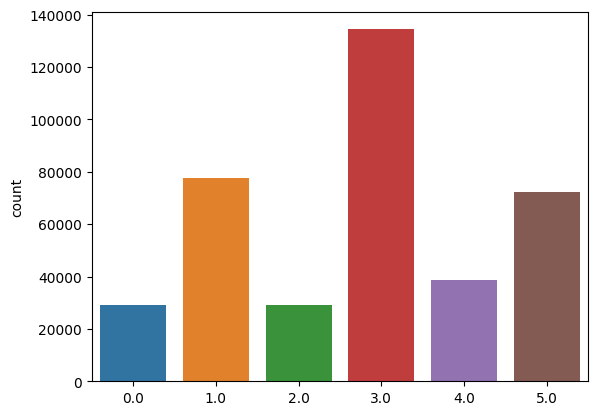

In [9]:
kb_rgcode = KBinsDiscretizer(n_bins=7, strategy='quantile', encode='ordinal')
output1 = kb_rgcode.fit_transform(pd.DataFrame(data['Region_Code']))

sns.countplot(np.reshape(output1, (381109 ,)))

In [10]:
kb_rgcode.bin_edges_

array([array([ 0.,  8., 17., 28., 33., 41., 52.])], dtype=object)

<AxesSubplot:ylabel='count'>

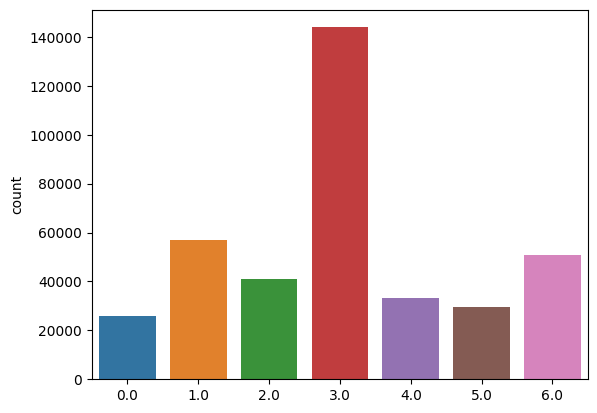

In [11]:
kb_rgcode_km = KBinsDiscretizer(n_bins=7, strategy='kmeans', encode='ordinal')
output2 = kb_rgcode_km.fit_transform(pd.DataFrame(data['Region_Code']))

sns.countplot(np.reshape(output2, (381109 ,)))

In [12]:
kb_rgcode_km.bin_edges_

array([array([ 0.        ,  6.14566113, 12.67078995, 22.26301589, 31.43911828,
              37.733843  , 43.89317621, 52.        ])                         ],
      dtype=object)

<AxesSubplot:ylabel='count'>

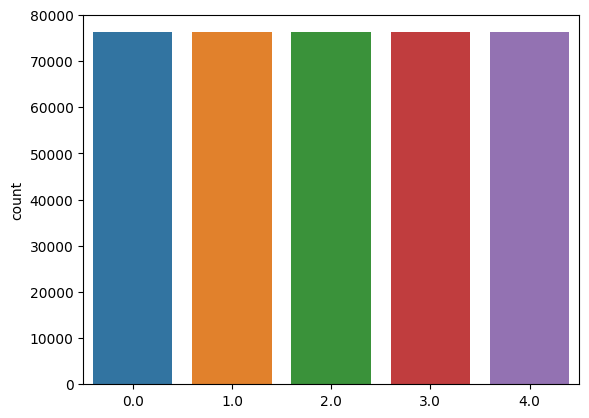

In [13]:
kb_ap_quant = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='quantile')
output3 = kb_ap_quant.fit_transform(pd.DataFrame(data['Annual_Premium']))

sns.countplot(np.reshape(output3, (381109 ,)))

In [14]:
kb_ap_quant.bin_edges_

array([array([  2630. ,  21583.6,  29082. ,  34406. ,  41711. , 540165. ])],
      dtype=object)

<AxesSubplot:ylabel='count'>

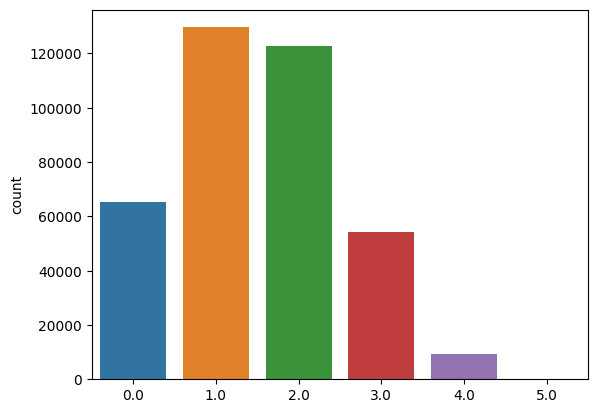

In [15]:
kb_ap_kmean = KBinsDiscretizer(n_bins=6, encode='ordinal', strategy='kmeans')
output4 = kb_ap_kmean.fit_transform(pd.DataFrame(data['Annual_Premium']))

sns.countplot(np.reshape(output4, (381109 ,)))

In [16]:
kb_ap_kmean.bin_edges_

array([array([  2630.        ,  14816.53102548,  31971.05817788,  43519.92636079,
               62851.12385812, 179962.83925786, 540165.        ])                ],
      dtype=object)

<AxesSubplot:ylabel='count'>

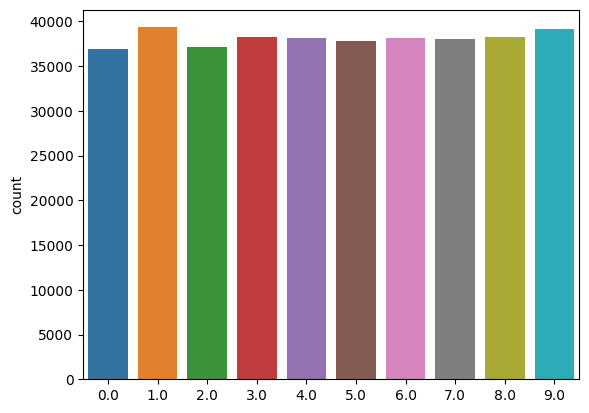

In [17]:
kb_vintage_quant = KBinsDiscretizer(n_bins=10, strategy='quantile', encode='ordinal')
output5 = kb_vintage_quant.fit_transform(pd.DataFrame(data['Vintage']))

sns.countplot(np.reshape(output5, (381109 ,)))

In [18]:
kb_vintage_quant.bin_edges_

array([array([ 10.,  38.,  68.,  96., 125., 154., 183., 212., 241., 270., 299.])],
      dtype=object)

<AxesSubplot:ylabel='count'>

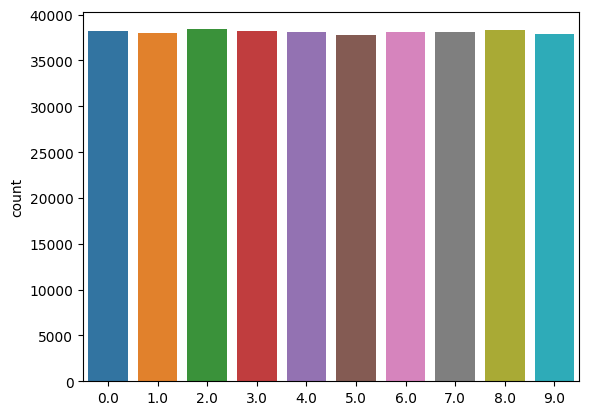

In [19]:
kb_vintage_kmean = KBinsDiscretizer(n_bins=10, strategy='kmeans', encode='ordinal')
output6 = kb_vintage_kmean.fit_transform(pd.DataFrame(data['Vintage']))

sns.countplot(np.reshape(output6, (381109 ,)))

In [20]:
kb_vintage_kmean.bin_edges_

array([array([ 10.        ,  38.5453785 ,  67.47407302,  96.48360491,
              125.4857276 , 154.43336621, 183.40430927, 212.43029424,
              241.44920037, 270.47495676, 299.        ])             ],
      dtype=object)

In [21]:
##Converting Age column in to 5 classes 

In [22]:
data['Age'] = data['Age'].astype(str)

In [23]:
data['Age'] = np.where(data['Age'].between('15','20'), 'Adolescence', data['Age'])
data['Age'] = np.where(data['Age'].between('21','30'), 'Early_adulthood', data['Age'])
data['Age'] = np.where(data['Age'].between('31','39'), 'Mid_life', data['Age'])
data['Age'] = np.where(data['Age'].between('40','65'), 'Mature_adulthood', data['Age'])
data['Age'] = np.where(data['Age'].between('66','90'), 'Late_adulthood', data['Age'])

In [24]:
data['Age'].unique()

array(['Mature_adulthood', 'Late_adulthood', 'Early_adulthood',
       'Mid_life', 'Adolescence'], dtype=object)

<AxesSubplot:xlabel='Age', ylabel='count'>

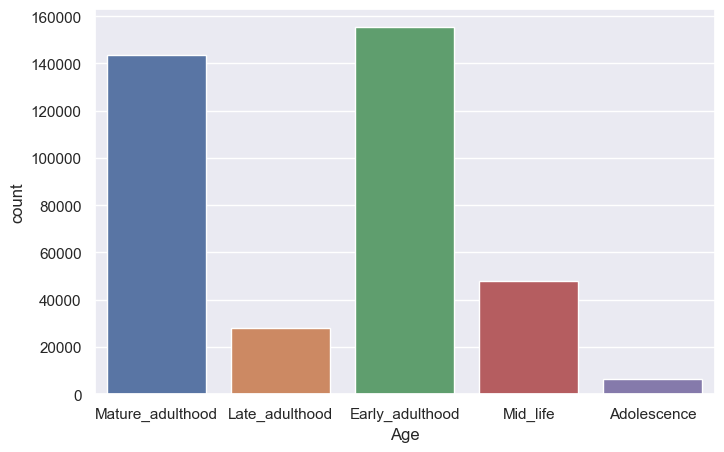

In [25]:
sns.set(rc={'figure.figsize':(8,5)})
sns.countplot(data['Age'])

In [26]:
data.sample(10)

,Gender,Age,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
132343,Male,Mature_adulthood,29.0,0,1-2 Year,Yes,32449.0,124.0,298,0
106917,Female,Early_adulthood,37.0,0,< 1 Year,Yes,38268.0,152.0,79,1
316008,Male,Early_adulthood,41.0,0,< 1 Year,Yes,31822.0,160.0,73,0
219698,Male,Mature_adulthood,28.0,0,1-2 Year,Yes,29078.0,124.0,271,1
67048,Male,Early_adulthood,28.0,0,1-2 Year,Yes,35093.0,156.0,37,0
139959,Male,Early_adulthood,12.0,1,< 1 Year,No,46768.0,160.0,115,0
229910,Male,Mature_adulthood,28.0,0,1-2 Year,Yes,2630.0,26.0,63,0
155166,Male,Mature_adulthood,15.0,1,1-2 Year,No,2630.0,26.0,273,0
374640,Male,Mature_adulthood,36.0,1,1-2 Year,No,66838.0,26.0,106,0
304853,Male,Early_adulthood,47.0,0,< 1 Year,Yes,30291.0,152.0,266,1


In [27]:
## Taking only top 10 categories in Policy_Sales_Channel 
## Remaining categories are combining to a single class called 'other'

In [28]:
top_10 = list(data['Policy_Sales_Channel'].value_counts().head(10).index)

top_10

[152.0, 26.0, 124.0, 160.0, 156.0, 122.0, 157.0, 154.0, 151.0, 163.0]

In [29]:
# data.query('Policy_Sales_Channel not in [152.0, 26.0, 124.0, 160.0, 156.0, 122.0, 157.0, 154.0, 151.0, 163.0]')

In [30]:
data['Policy_Sales_Channel'] = np.where(data['Policy_Sales_Channel'].isin(top_10), data['Policy_Sales_Channel'], 'other')

In [31]:
data['Policy_Sales_Channel'].value_counts()

152.0    134784
26.0      79700
124.0     73995
other     30805
160.0     21779
156.0     10661
122.0      9930
157.0      6684
154.0      5993
151.0      3885
163.0      2893
Name: Policy_Sales_Channel, dtype: int64

<AxesSubplot:xlabel='Policy_Sales_Channel', ylabel='count'>

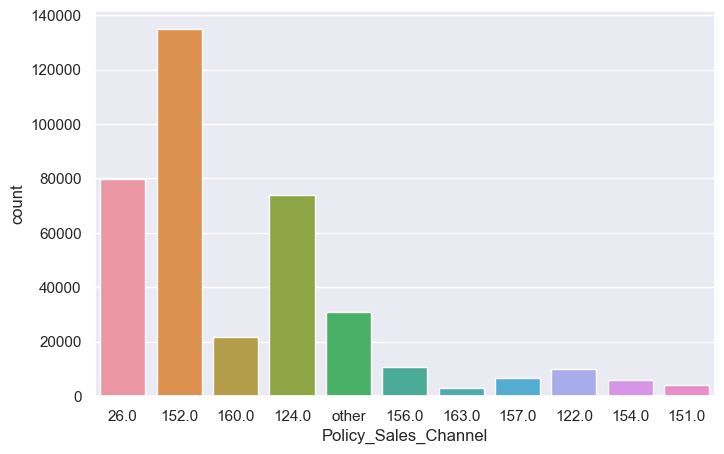

In [32]:
sns.countplot(data['Policy_Sales_Channel'])

In [33]:
data.sample(10)

,Gender,Age,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
82495,Female,Early_adulthood,41.0,1,< 1 Year,No,31876.0,152.0,231,0
247153,Female,Mid_life,4.0,0,1-2 Year,Yes,34879.0,124.0,120,1
244667,Female,Mature_adulthood,33.0,0,1-2 Year,Yes,29238.0,26.0,259,0
290676,Male,Early_adulthood,21.0,1,< 1 Year,No,27652.0,152.0,270,0
319384,Male,Mature_adulthood,11.0,1,1-2 Year,No,32465.0,154.0,36,0
365152,Female,Early_adulthood,41.0,0,< 1 Year,Yes,39461.0,152.0,298,1
148459,Male,Early_adulthood,46.0,1,< 1 Year,No,26613.0,160.0,46,0
115764,Male,Early_adulthood,47.0,1,< 1 Year,No,22878.0,152.0,260,0
99901,Female,Mature_adulthood,28.0,0,1-2 Year,Yes,38457.0,26.0,154,0
216354,Male,Late_adulthood,17.0,0,1-2 Year,No,32427.0,124.0,215,0


In [34]:
X = data.drop(columns=['Response'], axis='columns')
Y = data['Response']

### Column Transformer

In [35]:
col_transformer = ColumnTransformer([('ordinal_encoder', OrdinalEncoder(
                                                            categories=[['Adolescence', 'Early_adulthood', 'Mid_life', 'Mature_adulthood', 'Late_adulthood'],
                                                                        ['< 1 Year', '1-2 Year', '> 2 Years']], dtype= np.int64),
                                                            ['Age', 'Vehicle_Age']),
                                     
                                     ('one_hot_encoder', OneHotEncoder(categories='auto', drop='first'),
                                                                 ['Gender', 'Previously_Insured', 'Vehicle_Damage','Policy_Sales_Channel']),
                                     
                                     ('binning_region_code', KBinsDiscretizer(n_bins=7, strategy='quantile', encode='onehot-dense'), ['Region_Code']),
                                     
                                     ('binning_annual_premium', KBinsDiscretizer(n_bins=6, encode='onehot-dense', strategy='kmeans'), ['Annual_Premium']),
                                     
                                     ('binning_vintage', KBinsDiscretizer(n_bins=10, strategy='quantile', encode='onehot-dense'), ['Vintage'])],remainder='passthrough'
                                   
                                   )

In [36]:
data.head()

,Gender,Age,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,Male,Mature_adulthood,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,Male,Late_adulthood,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,Male,Mature_adulthood,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,Male,Early_adulthood,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,Female,Early_adulthood,41.0,1,< 1 Year,No,27496.0,152.0,39,0


In [37]:
trans = col_transformer.fit(X)

In [38]:
encoded_x = col_transformer.fit_transform(X)

In [39]:
encoded_x[0]

array([3., 2., 1., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.,
       0., 1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       1., 0., 0.])

In [40]:
len(encoded_x[0])

37

In [41]:
label_encoder = LabelEncoder()

In [42]:
encoded_y = label_encoder.fit_transform(Y)

encoded_y

array([1, 0, 1, ..., 0, 0, 0], dtype=int64)

## Preparing Validation dataset

In [43]:
## Saving the final dataset after Feature Engg

In [44]:
x_df = pd.DataFrame(encoded_x)

y_df = pd.DataFrame(encoded_y)

In [45]:
x_train, x_val, y_train, y_val = train_test_split(x_df, y_df, test_size=0.2, random_state=369)

In [46]:


x_train.to_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/processed_data/x_train.csv', index=False)
y_train.to_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/processed_data/y_train.csv', index=False)

x_val.to_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/processed_data/x_val.csv', index=False)
y_val.to_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/processed_data/y_val.csv', index=False)

## Preparing X_test 

In [47]:
x_test = pd.read_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/raw_data/test.csv')

In [48]:
x_test['Age'] = x_test['Age'].astype(str)

x_test['Age'] = np.where(x_test['Age'].between('15','20'), 'Adolescence', x_test['Age'])
x_test['Age'] = np.where(x_test['Age'].between('21','30'), 'Early_adulthood', x_test['Age'])
x_test['Age'] = np.where(x_test['Age'].between('31','39'), 'Mid_life', x_test['Age'])
x_test['Age'] = np.where(x_test['Age'].between('40','65'), 'Mature_adulthood', x_test['Age'])
x_test['Age'] = np.where(x_test['Age'].between('66','90'), 'Late_adulthood', x_test['Age'])

In [49]:
x_test['Policy_Sales_Channel'] = np.where(x_test['Policy_Sales_Channel'].isin(top_10), x_test['Policy_Sales_Channel'], 'other')

In [50]:
x_test['Policy_Sales_Channel'].value_counts()

152.0    44739
26.0     26894
124.0    24304
other    10216
160.0     7311
156.0     3652
122.0     3309
157.0     2274
154.0     1995
151.0     1386
163.0      957
Name: Policy_Sales_Channel, dtype: int64

In [51]:
test_x = pd.DataFrame(trans.transform(x_test))

In [52]:
test_x.to_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/processed_data/x_test.csv', index=False)

In [53]:
test_x.head()

,0,1,2,3,4,5,6,7,8,9,...,27,28,29,30,31,32,33,34,35,36
0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,3.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,3.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,1.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


# Model Training

In [3]:
def model_metrics_plots(model, x_train, y_train, x_val, y_val, model_name = "Random_Forest", fig_size =(15,15)):
    
    model.fit(x_train,y_train)
    pred_y_train = model.predict(x_train)
    pred_y_val = model.predict(x_val)
    
    
    fig, axes = plt.subplots(4, 2, figsize=fig_size)
    fig.suptitle(f"{model_name} model metrics")
    
    ConfusionMatrixDisplay.from_estimator(model, x_train, y_train, ax=axes[0,0])
    axes[0,0].set_title('Confusion matrix for Training Data')
    axes[0,0].grid(False)
    
    ConfusionMatrixDisplay.from_estimator(model, x_val, y_val, ax=axes[0,1])
    axes[0,1].set_title('Confusion matrix for Validation Data')
    axes[0,1].grid(False)
        
    ConfusionMatrixDisplay.from_estimator(model, x_train, y_train, ax=axes[1,0], normalize='true')
    axes[1,0].set_title('Normalized Confusion matrix for Training Data')
    axes[1,0].grid(False)
    
    ConfusionMatrixDisplay.from_estimator(model, x_val, y_val, ax=axes[1,1],normalize='true')
    axes[1,1].set_title('Normalized Confusion matrix for Validation Data')
    axes[1,1].grid(False)
    
    RocCurveDisplay.from_estimator(model, x_train, y_train, ax=axes[2,0])
    axes[2,0].set_title('ROC for Training Data')
    
    RocCurveDisplay.from_estimator(model, x_val, y_val, ax=axes[2,1])
    axes[2,1].set_title('ROC for Validation Data')
    
    PrecisionRecallDisplay.from_estimator(model, x_train, y_train, ax=axes[3,0])
    axes[3,0].set_title('Precsion-Recall curve for Training Data')
    
    PrecisionRecallDisplay.from_estimator(model, x_val, y_val, ax=axes[3,1])
    axes[3,1].set_title('Precsion-Recall curve for Validation Data')
    
    print("Classification Report of Training data\n")
    print(classification_report(y_train,pred_y_train))
    print("Classification Report of Validation data\n")
    print(classification_report(y_val,pred_y_val))
    
    

In [25]:
def plotly_prc(model,x_train, y_train, x_val, y_val, fig_width = 700, fig_height=500):
    
    model.fit(x_train, y_train)
    
    val_count_minority_train = y_train.value_counts()[1]
    base_model_cordinate_train = np.round(val_count_minority_train/len(y_train), 2)
    
    val_count_minority_val = y_val.value_counts()[1]
    base_model_cordinate_val = np.round(val_count_minority_val/len(y_val), 2)
    
    pred_train = model.predict_proba(x_train)[:, 1]
    pred_val = model.predict_proba(x_val)[:, 1]
    
    precision_train, recall_train, thresholds_train = precision_recall_curve(y_train,pred_train)
    precision_val, recall_val, thresholds_val = precision_recall_curve(y_val,pred_val)

    thresholds_train = np.append(thresholds_train, -1)
    thresholds_val = np.append(thresholds_val, -1)
    
        
    fig_1 = px.area(
        x = recall_train, 
        y=precision_train,
        hover_data=[thresholds_train],
        title=f'Precision-Recall Curve Train data (AUC={auc(recall_train, precision_train):.2f})',
        labels=dict(x='Recall', y='Precision'),
        width=fig_width, 
        height=fig_height)

    fig_1.add_shape(
        type='line', 
        line=dict(dash='dash'),
        x0=0, 
        x1=1, 
        y0=base_model_cordinate_train, 
        y1=base_model_cordinate_train)

    #fig_1.update_yaxes(scaleanchor="x", scaleratio=1)
    #fig_1.update_xaxes(constrain='domain')
    
    
    
    
    fig_2 = px.area(
        x = recall_val, 
        y=precision_val,
        hover_data=[thresholds_val],
        title=f'Precision-Recall Curve Validation data (AUC={auc(recall_val, precision_val):.2f})',
        labels=dict(x='Recall', y='Precision'),
        width=fig_width, 
        height=fig_height)

    fig_2.add_shape(
        type='line', 
        line=dict(dash='dash'),
        x0=0, 
        x1=1, 
        y0=base_model_cordinate_val, 
        y1=base_model_cordinate_val)

    #fig_2.update_yaxes(scaleanchor="x", scaleratio=1)
    #fig_2.update_xaxes(constrain='domain')

    
    fig_1.show()
    fig_2.show()
    
    return fig_1, fig_2
    
    

In [40]:
# Reading dataset

x_train = pd.read_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/processed_data/x_train.csv')
y_train = pd.read_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/processed_data/y_train.csv')

x_val = pd.read_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/processed_data/x_val.csv')
y_val = pd.read_csv('D:/Ineuron/Project_workshop/Cross_Selling/Data/processed_data/y_val.csv')

## Baseline Classifier

In [6]:
model_dummy = DummyClassifier(strategy='stratified')
model_dummy.fit(x_train, y_train)

DummyClassifier(strategy='stratified')

Classification Report of Training data

              precision    recall  f1-score   support

           0       0.88      0.88      0.88    267541
           1       0.12      0.12      0.12     37346

    accuracy                           0.78    304887
   macro avg       0.50      0.50      0.50    304887
weighted avg       0.78      0.78      0.78    304887

Classification Report of Validation data

              precision    recall  f1-score   support

           0       0.88      0.87      0.88     66858
           1       0.12      0.13      0.12      9364

    accuracy                           0.78     76222
   macro avg       0.50      0.50      0.50     76222
weighted avg       0.78      0.78      0.78     76222



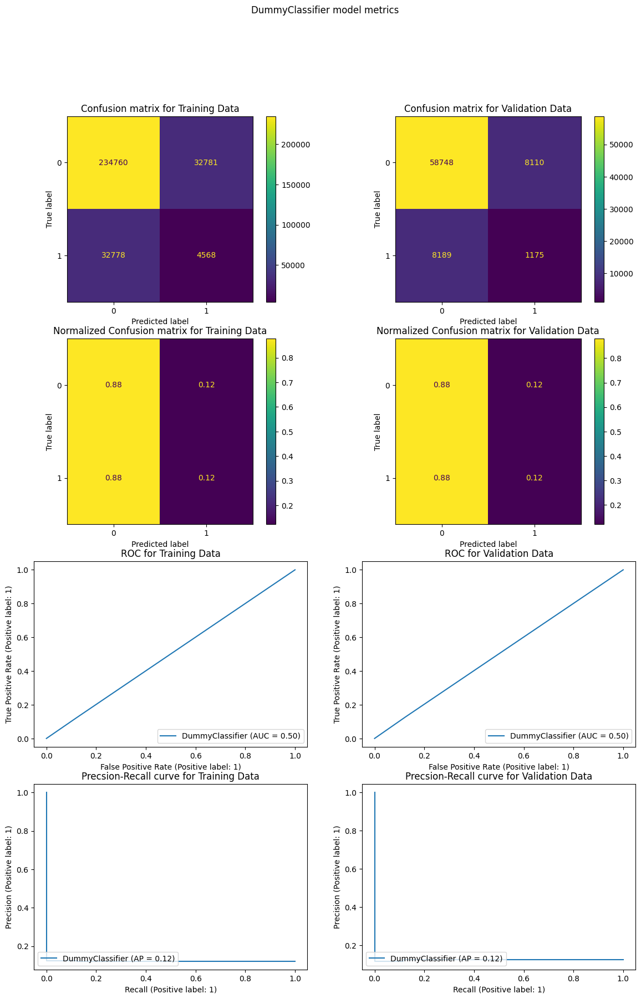

In [7]:
model_metrics_plots(model_dummy, x_train, y_train, x_val, y_val, model_name = "DummyClassifier",fig_size =(14,20))

In [27]:
fig_1, fig_2 = plotly_prc(model_dummy, x_train, y_train, x_val, y_val, fig_width = 700, fig_height=500)

In [37]:
import plotly.io as pio

pio.write_html(fig_1, file='fig_1.html', auto_open=True)
pio.write_html(fig_2, file='fig_2.html', auto_open=True)

## 1) RandomForestClassifier

In [10]:
rf = RandomForestClassifier(max_depth=100, n_estimators = 500)

In [ ]:
rf.fit(x_train, y_train)

Classification Report of Training data

              precision    recall  f1-score   support

           0       0.90      0.99      0.94    267541
           1       0.73      0.18      0.29     37346

    accuracy                           0.89    304887
   macro avg       0.81      0.59      0.61    304887
weighted avg       0.88      0.89      0.86    304887

Classification Report of Validation data

              precision    recall  f1-score   support

           0       0.88      0.98      0.93     66858
           1       0.37      0.09      0.14      9364

    accuracy                           0.87     76222
   macro avg       0.63      0.53      0.53     76222
weighted avg       0.82      0.87      0.83     76222



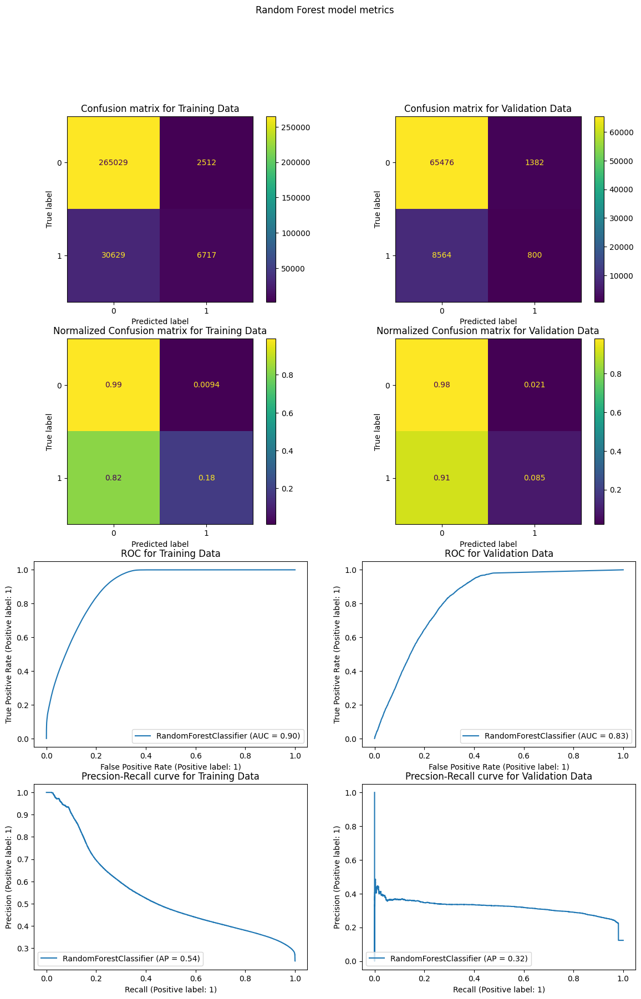

In [11]:
model_metrics_plots(rf, x_train, y_train, x_val, y_val, model_name = "Random Forest", fig_size =(14,20))

In [29]:
fig_rf1, fig_rf2 = plotly_prc(rf, x_train, y_train, x_val, y_val, fig_width = 700, fig_height=500)

In [30]:
pio.write_html(fig_rf1, file='fig_rf1.html', auto_open=True)
pio.write_html(fig_rf2, file='fig_rf2.html', auto_open=True)

## 2) BalancedRandomForestClassifier

In [ ]:
params_rf = [{'n_estimators': [100,200,300,500,1000],
         'class_weight': ['balanced', 'balanced_subsample'],
         'criterion': ['gini', 'entropy'],
         'max_depth': [20,50,70,100, 150, 200, 300, 500]}]


# cv = StratifiedKFold(n_splits=5)


balanced_rf = BalancedRandomForestClassifier(verbose=1)

balanced_rf_grid = RandomizedSearchCV(balanced_rf, param_distributions=params_rf, n_iter=30, cv=5, verbose=True)

best_clf = balanced_rf_grid.fit(x_train, y_train)

In [ ]:
print(best_clf.best_score_)
print(best_clf.best_params_)


#0.6964547529940509
#{'n_estimators': 500, 'max_depth': 500, 'criterion': 'gini', 'class_weight': 'balanced_subsample'}

In [13]:
final_model_brf = BalancedRandomForestClassifier(n_estimators= 500, max_depth=500, criterion='gini', class_weight='balanced_subsample')

In [ ]:
final_model_brf.fit(x_train, y_train)

Classification Report of Training data

              precision    recall  f1-score   support

           0       0.99      0.68      0.80    267541
           1       0.29      0.97      0.45     37346

    accuracy                           0.71    304887
   macro avg       0.64      0.82      0.63    304887
weighted avg       0.91      0.71      0.76    304887

Classification Report of Validation data

              precision    recall  f1-score   support

           0       0.98      0.67      0.79     66858
           1       0.28      0.91      0.42      9364

    accuracy                           0.70     76222
   macro avg       0.63      0.79      0.61     76222
weighted avg       0.89      0.70      0.75     76222



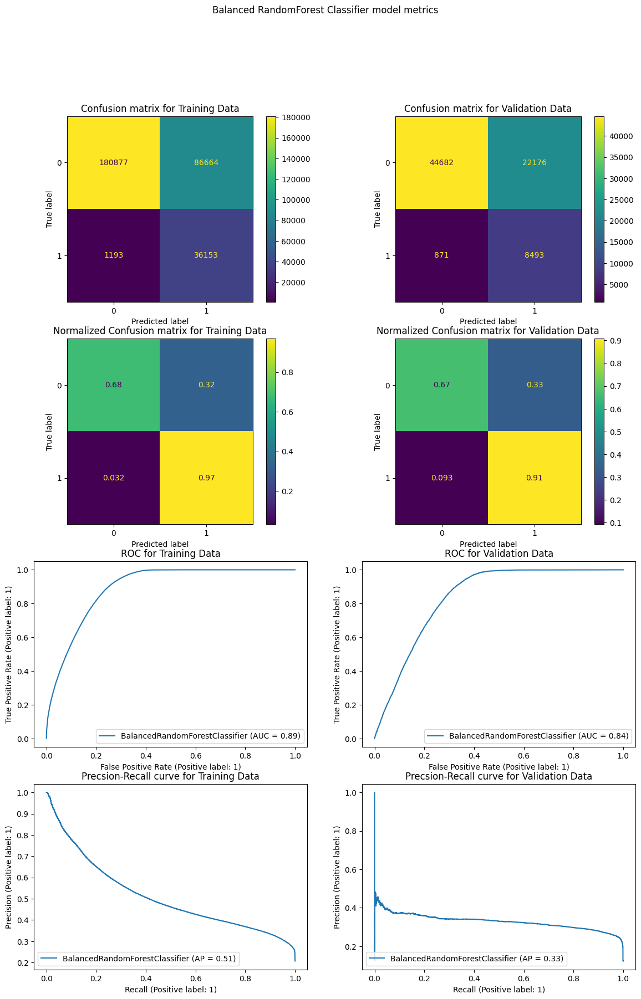

In [14]:
model_metrics_plots(final_model_brf, x_train, y_train, x_val, y_val, model_name = "Balanced RandomForest Classifier", fig_size =(14,20))

In [31]:
fig_brf1, fig_brf2 = plotly_prc(final_model_brf, x_train, y_train, x_val, y_val, fig_width = 700, fig_height=500)

In [32]:
pio.write_html(fig_brf1, file='fig_brf1.html', auto_open=True)
pio.write_html(fig_brf2, file='fig_brf2.html', auto_open=True)

## 3) XGBoost Classifier

In [ ]:
model_xgb = XGBClassifier(verbosity=3)

params = {'n_estimators': np.random.randint(100, 300, 15),
                      'booster': ['gbtree', 'dart'],
                      'scale_pos_weight': np.random.randint(1, 1000, 5)}

In [ ]:
xgb_grid = RandomizedSearchCV(estimator=model_xgb,
                                param_distributions=params,
                                n_iter=30, cv=3, verbose=True
                                )

In [ ]:
# Fitting n the estimator provided
model_grid_xgb = xgb_grid.fit(x_train, y_train)

In [ ]:
model_grid_xgb.best_score_

In [ ]:
model_grid_xgb.best_params_

In [16]:
model_xgb = XGBClassifier(scale_pos_weight=261,n_estimators=286, booster='gbtree')

In [ ]:
model_xgb.fit(x_train, y_train)

Classification Report of Training data

              precision    recall  f1-score   support

           0       1.00      0.56      0.71    267541
           1       0.24      1.00      0.39     37346

    accuracy                           0.61    304887
   macro avg       0.62      0.78      0.55    304887
weighted avg       0.91      0.61      0.67    304887

Classification Report of Validation data

              precision    recall  f1-score   support

           0       1.00      0.55      0.71     66858
           1       0.24      0.99      0.38      9364

    accuracy                           0.61     76222
   macro avg       0.62      0.77      0.55     76222
weighted avg       0.90      0.61      0.67     76222



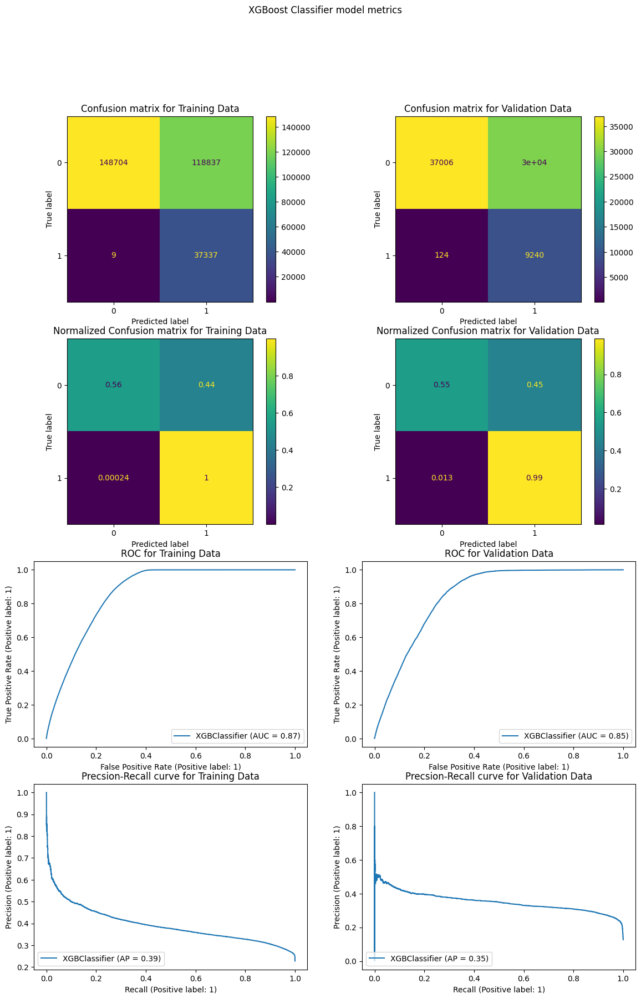

In [17]:
model_metrics_plots(model_xgb, x_train, y_train, x_val, y_val, model_name = "XGBoost Classifier", fig_size =(14,20))

In [33]:
fig_xgb1, fig_xgb2 = plotly_prc(model_xgb, x_train, y_train, x_val, y_val, fig_width = 700, fig_height=500)

In [34]:
pio.write_html(fig_xgb1, file='fig_xgb1.html', auto_open=True)
pio.write_html(fig_xgb2, file='fig_xgb2.html', auto_open=True)

## 4) Logistic regression

In [92]:
weights = np.linspace(0.01, 0.99, 15)

params = [{'penalty': ['l1', 'l2', 'elasticnet', 'none'],
         'C': np.linspace(0.001, 2.0, 100),
         'solver': ['lbfgs', 'newton-cg', 'liblinear', 'sag', 'saga'],
         'class_weight': [{0: x, 1: 1.0 - x} for x in weights],
         'max_iter': [100, 500, 1000]}]

In [96]:
lr = LogisticRegression()
lr_grid = RandomizedSearchCV(lr, param_distributions=params, n_iter=30, cv=5, verbose=True)

lr_grid_cv = lr_grid.fit(x_train, y_train)

Fitting 5 folds for each of 30 candidates, totalling 150 fits


In [97]:
lr_grid_cv.best_score_

0.8775087163684547

In [98]:
lr_grid_cv.best_params_

{'solver': 'sag',
 'penalty': 'l2',
 'max_iter': 1000,
 'class_weight': {0: 0.99, 1: 0.010000000000000009},
 'C': 0.8086767676767677}

In [ ]:
#{'solver': 'sag',  'penalty': 'l2', 'max_iter': 1000, 'class_weight': {0: 0.99, 1: 0.010000000000000009}, 'C': 0.8086767676767677}

In [19]:
final_lr = LogisticRegression(solver='sag',penalty='l2', max_iter=1000,class_weight={0: 0.99, 1: 0.010000000000000009},C = 0.8086767676767677)

In [ ]:
final_lr.fit(x_train, y_train)

Classification Report of Training data

              precision    recall  f1-score   support

           0       0.88      1.00      0.93    267541
           1       0.00      0.00      0.00     37346

    accuracy                           0.88    304887
   macro avg       0.44      0.50      0.47    304887
weighted avg       0.77      0.88      0.82    304887

Classification Report of Validation data

              precision    recall  f1-score   support

           0       0.88      1.00      0.93     66858
           1       0.00      0.00      0.00      9364

    accuracy                           0.88     76222
   macro avg       0.44      0.50      0.47     76222
weighted avg       0.77      0.88      0.82     76222



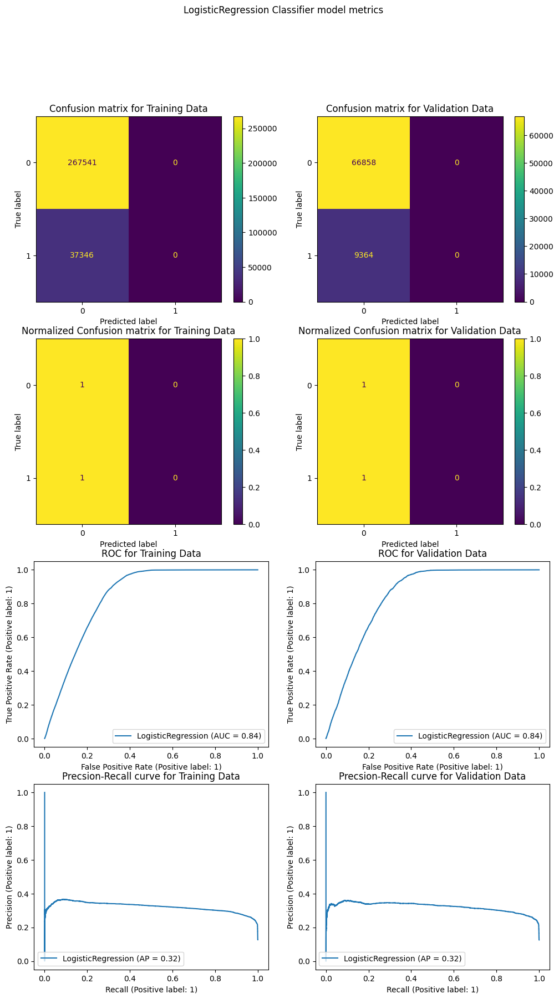

In [20]:
model_metrics_plots(final_lr, x_train, y_train, x_val, y_val, model_name = "LogisticRegression Classifier", fig_size =(12,20))

In [35]:
fig_lr1, fig_lr2 = plotly_prc(final_lr, x_train, y_train, x_val, y_val, fig_width = 700, fig_height=500)

In [36]:
pio.write_html(fig_lr1, file='fig_lr1.html', auto_open=True)
pio.write_html(fig_lr2, file='fig_lr2.html', auto_open=True)